# Deep Learning Lab

In this notebook, we use deep learning architectures for regression analysis and classification analysis. We begin with installing/ importing all the necessary packages. Then, we use a deep learning model for a regression task. Finally, we use a deep learning model for a classification task. 

In [39]:
# # Install packages:

# !pip install pandas
# !pip install tensorflow
# !pip install keras
# !pip install seaborn
# !pip install category_encoders

In [40]:
# Import packages:

import sys
import pandas as pd
pd.set_option('display.max_rows', 50)
import numpy as np
np.set_printoptions(threshold=sys.maxsize)
import matplotlib.pyplot as plt
import seaborn as sns
from category_encoders import *

# sklearn imports:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import MinMaxScaler

# keras imports:
from keras.models import Sequential
from keras.layers import Dense
from keras.wrappers.scikit_learn import KerasRegressor
from keras.backend import clear_session

## 1. Deep Learning for Regression

Each row in the dataset corresponds to a property that was inspected and given a hazard score ("Hazard"). You can think of the hazard score as a continuous number that represents the condition of the property as determined by the inspection. Some inspection hazards are major and contribute more to the total score, while some are minor and contribute less. The total score for a property is the sum of the individual hazards.

The aim of the competition is to forecast the hazard score based on anonymized variables which are available before an inspection is ordered.

Source: https://www.kaggle.com/c/liberty-mutual-group-property-inspection-prediction/data

In [41]:
df = pd.read_csv("data/insurance.csv")

df.head()

,Id,Hazard,T1_V1,T1_V2,T1_V3,T1_V4,T1_V5,T1_V6,T1_V7,T1_V8,...,T2_V6,T2_V7,T2_V8,T2_V9,T2_V10,T2_V11,T2_V12,T2_V13,T2_V14,T2_V15
0,1,1,15,3,2,N,B,N,B,B,...,2,37,1,11,6,Y,N,E,2,2
1,2,4,16,14,5,H,B,N,B,B,...,2,22,1,18,5,Y,Y,E,2,1
2,3,1,10,10,5,N,K,N,B,B,...,6,37,2,14,6,Y,Y,E,6,1
3,4,1,18,18,5,N,K,N,B,B,...,2,25,1,1,6,Y,N,C,2,6
4,5,1,13,19,5,N,H,N,B,B,...,1,22,1,2,7,N,N,E,1,1


In [42]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50999 entries, 0 to 50998
Data columns (total 34 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Id      50999 non-null  int64 
 1   Hazard  50999 non-null  int64 
 2   T1_V1   50999 non-null  int64 
 3   T1_V2   50999 non-null  int64 
 4   T1_V3   50999 non-null  int64 
 5   T1_V4   50999 non-null  object
 6   T1_V5   50999 non-null  object
 7   T1_V6   50999 non-null  object
 8   T1_V7   50999 non-null  object
 9   T1_V8   50999 non-null  object
 10  T1_V9   50999 non-null  object
 11  T1_V10  50999 non-null  int64 
 12  T1_V11  50999 non-null  object
 13  T1_V12  50999 non-null  object
 14  T1_V13  50999 non-null  int64 
 15  T1_V14  50999 non-null  int64 
 16  T1_V15  50999 non-null  object
 17  T1_V16  50999 non-null  object
 18  T1_V17  50999 non-null  object
 19  T2_V1   50999 non-null  int64 
 20  T2_V2   50999 non-null  int64 
 21  T2_V3   50999 non-null  object
 22  T2_V4   50999 non-null

In [43]:
df.columns

Index(['Id', 'Hazard', 'T1_V1', 'T1_V2', 'T1_V3', 'T1_V4', 'T1_V5', 'T1_V6',
       'T1_V7', 'T1_V8', 'T1_V9', 'T1_V10', 'T1_V11', 'T1_V12', 'T1_V13',
       'T1_V14', 'T1_V15', 'T1_V16', 'T1_V17', 'T2_V1', 'T2_V2', 'T2_V3',
       'T2_V4', 'T2_V5', 'T2_V6', 'T2_V7', 'T2_V8', 'T2_V9', 'T2_V10',
       'T2_V11', 'T2_V12', 'T2_V13', 'T2_V14', 'T2_V15'],
      dtype='object')

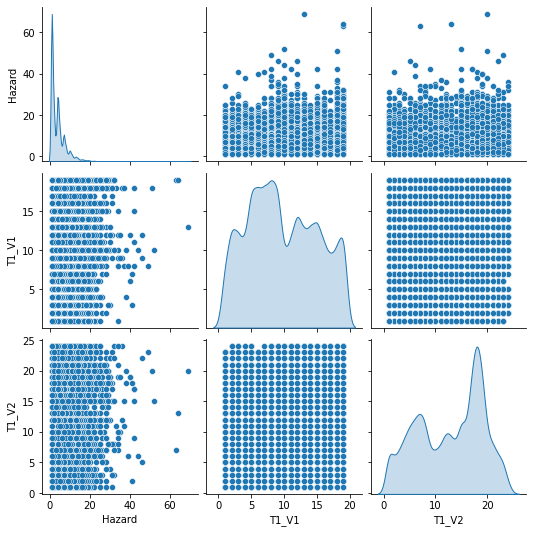

In [44]:
sns.pairplot(df[['Hazard','T1_V1', 'T1_V2' ]], diag_kind='kde')

In [45]:
cat_cols = list(df.select_dtypes(include=['O']).columns) # find columns of data type object (categorical variables)

In [46]:
encoder = BaseNEncoder(cols=cat_cols).fit(df)

df = encoder.transform(df)

df.head()

C:\Users\greer\AppData\Local\Programs\Python\Python38\lib\site-packages\category_encoders\utils.py:21: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  elif pd.api.types.is_categorical(cols):


,Id,Hazard,T1_V1,T1_V2,T1_V3,T1_V4_0,T1_V4_1,T1_V4_2,T1_V4_3,T1_V5_0,...,T2_V11_0,T2_V11_1,T2_V12_0,T2_V12_1,T2_V13_0,T2_V13_1,T2_V13_2,T2_V13_3,T2_V14,T2_V15
0,1,1,15,3,2,0,0,0,1,0,...,0,1,0,1,0,0,0,1,2,2
1,2,4,16,14,5,0,0,1,0,0,...,0,1,1,0,0,0,0,1,2,1
2,3,1,10,10,5,0,0,0,1,0,...,0,1,1,0,0,0,0,1,6,1
3,4,1,18,18,5,0,0,0,1,0,...,0,1,0,1,0,0,1,0,2,6
4,5,1,13,19,5,0,0,0,1,0,...,1,0,0,1,0,0,0,1,1,1


In [47]:
df.columns

Index(['Id', 'Hazard', 'T1_V1', 'T1_V2', 'T1_V3', 'T1_V4_0', 'T1_V4_1',
       'T1_V4_2', 'T1_V4_3', 'T1_V5_0', 'T1_V5_1', 'T1_V5_2', 'T1_V5_3',
       'T1_V5_4', 'T1_V6_0', 'T1_V6_1', 'T1_V7_0', 'T1_V7_1', 'T1_V7_2',
       'T1_V8_0', 'T1_V8_1', 'T1_V8_2', 'T1_V9_0', 'T1_V9_1', 'T1_V9_2',
       'T1_V9_3', 'T1_V10', 'T1_V11_0', 'T1_V11_1', 'T1_V11_2', 'T1_V11_3',
       'T1_V11_4', 'T1_V12_0', 'T1_V12_1', 'T1_V12_2', 'T1_V13', 'T1_V14',
       'T1_V15_0', 'T1_V15_1', 'T1_V15_2', 'T1_V15_3', 'T1_V16_0', 'T1_V16_1',
       'T1_V16_2', 'T1_V16_3', 'T1_V16_4', 'T1_V16_5', 'T1_V17_0', 'T1_V17_1',
       'T2_V1', 'T2_V2', 'T2_V3_0', 'T2_V3_1', 'T2_V4', 'T2_V5_0', 'T2_V5_1',
       'T2_V5_2', 'T2_V5_3', 'T2_V6', 'T2_V7', 'T2_V8', 'T2_V9', 'T2_V10',
       'T2_V11_0', 'T2_V11_1', 'T2_V12_0', 'T2_V12_1', 'T2_V13_0', 'T2_V13_1',
       'T2_V13_2', 'T2_V13_3', 'T2_V14', 'T2_V15'],
      dtype='object')

In [48]:
X = df.drop(columns = ['Id', 'Hazard']) # Drop Id and Hazard from the list of predictors
Y = df.Hazard # This is what we want to predict 

It is good practice to rescale features that use different scales and ranges.

One reason this is important is because the features are multiplied by the model weights. So the scale of the outputs and the scale of the gradients are affected by the scale of the inputs.

Although a model might converge without scaling, scaling the input data makes training much more stable.

In [49]:
scalar = MinMaxScaler()
scalar.fit(X)
X = scalar.transform(X)

After scaling our data, we can go ahead and split it to train and test subsets:

In [50]:
trainData, testData, trainLabels, testLabels = train_test_split(X, Y, test_size=.2, random_state = 1)

Now, we train the neural network. We are using the input variables ('T1_V1', 'T1_V2', 'T1_V3', ...), along with two hidden layers of 100 and 50 neurons respectively, and finally using the linear activation function to process the output.

In [51]:
# Clear the previous model:
clear_session()

model = Sequential()
model.add(Dense(71, # Number of nodes in the first layer 
                input_dim=71, # Number of inputs (predictors)
                activation='relu' # Activation function for this layer
               ))
model.add(Dense(50, activation='relu'))
model.add(Dense(1, activation='linear'))
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 71)                5112      
_________________________________________________________________
dense_1 (Dense)              (None, 50)                3600      
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 51        
Total params: 8,763
Trainable params: 8,763
Non-trainable params: 0
_________________________________________________________________


After designing the network architecture, we can go ahead and compile it:

In [52]:
model.compile(loss='mse', optimizer='adam', metrics=['mse','mae'])

And finally, we can go ahead and fit the model using the train data:

In [53]:
history = model.fit(trainData, trainLabels, # Data to be used for fitting/ training the model
                    epochs=150, # Number times that the learning algorithm will work through the training data
                    batch_size=50, # Number of samples to be used in each iteration
                    verbose=1, # Whether to print the progress 
                    validation_split=0.2 # The portion of samples to be used for validation (different from our test data)
                   )

15.2594 - val_mse: 15.2594 - val_mae: 2.7854
Epoch 33/150
653/653 [==============================] - 1s 1ms/step - loss: 12.4451 - mse: 12.4451 - mae: 2.5620 - val_loss: 15.1475 - val_mse: 15.1475 - val_mae: 2.7607
Epoch 34/150
653/653 [==============================] - 1s 1ms/step - loss: 12.4541 - mse: 12.4541 - mae: 2.5595 - val_loss: 15.1836 - val_mse: 15.1836 - val_mae: 2.8000
Epoch 35/150
653/653 [==============================] - 1s 1ms/step - loss: 12.3614 - mse: 12.3614 - mae: 2.5700 - val_loss: 15.6819 - val_mse: 15.6819 - val_mae: 2.8300
Epoch 36/150
653/653 [==============================] - 1s 1ms/step - loss: 12.2788 - mse: 12.2788 - mae: 2.5550 - val_loss: 15.3044 - val_mse: 15.3044 - val_mae: 2.8126
Epoch 37/150
653/653 [==============================] - 1s 1ms/step - loss: 12.0330 - mse: 12.0330 - mae: 2.5368 - val_loss: 15.3015 - val_mse: 15.3015 - val_mae: 2.8219
Epoch 38/150
653/653 [==============================] - 1s 1ms/step - loss: 11.8552 - mse: 11.8552 - mae:

We can now visualize the loss (MSE) for training and validation data over the epochs:

dict_keys(['loss', 'mse', 'mae', 'val_loss', 'val_mse', 'val_mae'])


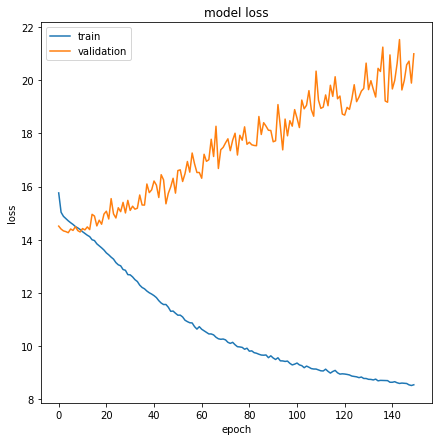

In [54]:
print(history.history.keys())
# "Loss"
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

And finally, we can use the model to make predictions over our test data:

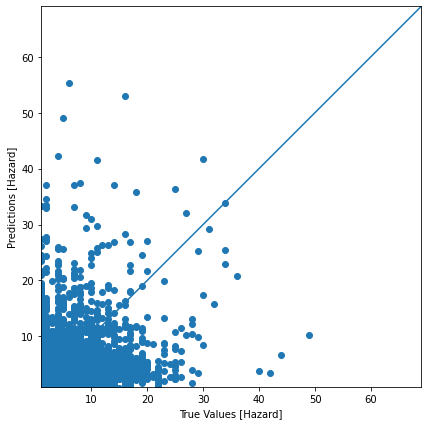

In [55]:
test_predictions = model.predict(testData).flatten()

a = plt.axes(aspect='equal')
plt.scatter(testLabels, test_predictions)
plt.xlabel('True Values [Hazard]')
plt.ylabel('Predictions [Hazard]')
lims = [Y.min(), Y.max()]
plt.xlim(lims)
plt.ylim(lims)
_ = plt.plot(lims, lims)

## 2. Deep Learning for Classification

In the example below, we use U.S. Adult Salary data set to predict whether a household’s income is above or below $50K. The data is obtained from U.S. Census and includes the following columns:

age: Age of the head of household.

workclass: Private, Self-emp-not-inc, Self-emp-inc, Federal-gov, Local-gov, State-gov, Without-pay, Never-worked.

fnlwgt: continuous. Not useful for the analysis and should be excluded.

education: Bachelors, Some-college, 11th, HS-grad, Prof-school, Assoc-acdm, Assoc-voc, 9th, 7th-8th, 12th, Masters, 1st-4th, 10th, Doctorate, 5th-6th, Preschool.

education-num: continuous. Contains the same information in education, but represented by numbers instead of characters.

marital-status: Married-civ-spouse, Divorced, Never-married, Separated, Widowed, Married-spouse-absent, Married-AF-spouse.

occupation: Tech-support, Craft-repair, Other-service, Sales, Exec-managerial, Prof-specialty, Handlers-cleaners, Machine-op-inspct, Adm-clerical, Farming-fishing, Transport-moving, Priv-house-serv, Protective-serv, Armed-Forces.

relationship: Wife, Own-child, Husband, Not-in-family, Other-relative, Unmarried. Not usefule for the analysis and should be excluded.

race: White, Asian-Pac-Islander, Amer-Indian-Eskimo, Other, Black.

sex: Female, Male.

capital-gain: continuous.

capital-loss:continuous.

hours-per-week: continuous.

native-country: United-States, Cambodia, England, Puerto-Rico, Canada, Germany, Outlying-US(Guam-USVI-etc), India, Japan, Greece, South, China, Cuba, Iran, Honduras, Philippines, Italy, Poland, Jamaica, Vietnam, Mexico, Portugal, Ireland, France, Dominican-Republic, Laos, Ecuador, Taiwan, Haiti, Columbia, Hungary, Guatemala, Nicaragua, Scotland, Thailand, Yugoslavia, El-Salvador, Trinadad&Tobago, Peru, Hong, Holand-Netherlands.

salary: Whether the household makes over $50K or not.

Missing values are noted in the data using ?. For more information about this dataset, please refer to: https://archive.ics.uci.edu/ml/datasets/adult

We go ahead and import the data. As we import the data in Pandas, we make sure we indicate the symbol for missing values. We also change the column names to make them more consistent:

In [56]:
data = pd.read_csv('data/adult.csv', na_values = '?')
data.columns = ['age','workclass','fnlwgt','education','education-num','marital-status',
               'occupation','relationship','race','sex','capital-gain','capital-loss',
               'hours-per-week','native-country','salary']
data.head(2)

,age,workclass,fnlwgt,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,native-country,salary
0,90,NaN,77053,HS-grad,9,Widowed,NaN,Not-in-family,White,Female,0,4356,40,United-States,<=50K
1,82,Private,132870,HS-grad,9,Widowed,Exec-managerial,Not-in-family,White,Female,0,4356,18,United-States,<=50K


From these columns some of them are either not useful or redundant. Therefore, we remove them from our data:

In [57]:
data.drop(columns = ['fnlwgt', # Not useful
                     'education', # Redundant
                     'relationship' # Not useful
                    ], inplace = True # Overwrite data
         )

data.head(2)

,age,workclass,education-num,marital-status,occupation,race,sex,capital-gain,capital-loss,hours-per-week,native-country,salary
0,90,NaN,9,Widowed,NaN,White,Female,0,4356,40,United-States,<=50K
1,82,Private,9,Widowed,Exec-managerial,White,Female,0,4356,18,United-States,<=50K


We can take a look at some descriptive information from the data:

In [58]:
data.describe(include = 'all')

,age,workclass,education-num,marital-status,occupation,race,sex,capital-gain,capital-loss,hours-per-week,native-country,salary
count,32561.000000,30725,32561.000000,32561,30718,32561,32561,32561.000000,32561.000000,32561.000000,31978,32561
unique,NaN,8,NaN,7,14,5,2,NaN,NaN,NaN,41,2
top,NaN,Private,NaN,Married-civ-spouse,Prof-specialty,White,Male,NaN,NaN,NaN,United-States,<=50K
freq,NaN,22696,NaN,14976,4140,27816,21790,NaN,NaN,NaN,29170,24720
mean,38.581647,NaN,10.080679,NaN,NaN,NaN,NaN,1077.648844,87.303830,40.437456,NaN,NaN
std,13.640433,NaN,2.572720,NaN,NaN,NaN,NaN,7385.292085,402.960219,12.347429,NaN,NaN
min,17.000000,NaN,1.000000,NaN,NaN,NaN,NaN,0.000000,0.000000,1.000000,NaN,NaN
25%,28.000000,NaN,9.000000,NaN,NaN,NaN,NaN,0.000000,0.000000,40.000000,NaN,NaN
50%,37.000000,NaN,10.000000,NaN,NaN,NaN,NaN,0.000000,0.000000,40.000000,NaN,NaN
75%,48.000000,NaN,12.000000,NaN,NaN,NaN,NaN,0.000000,0.000000,45.000000,NaN,NaN


We can also check what data types we have in this data:

In [59]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32561 entries, 0 to 32560
Data columns (total 12 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   age             32561 non-null  int64 
 1   workclass       30725 non-null  object
 2   education-num   32561 non-null  int64 
 3   marital-status  32561 non-null  object
 4   occupation      30718 non-null  object
 5   race            32561 non-null  object
 6   sex             32561 non-null  object
 7   capital-gain    32561 non-null  int64 
 8   capital-loss    32561 non-null  int64 
 9   hours-per-week  32561 non-null  int64 
 10  native-country  31978 non-null  object
 11  salary          32561 non-null  object
dtypes: int64(5), object(7)
memory usage: 3.0+ MB


We see that there are several rows with missing values. We go ahead and drop all the row with any missing values from the data:

In [60]:
data.dropna(inplace = True)

In [61]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30162 entries, 1 to 32560
Data columns (total 12 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   age             30162 non-null  int64 
 1   workclass       30162 non-null  object
 2   education-num   30162 non-null  int64 
 3   marital-status  30162 non-null  object
 4   occupation      30162 non-null  object
 5   race            30162 non-null  object
 6   sex             30162 non-null  object
 7   capital-gain    30162 non-null  int64 
 8   capital-loss    30162 non-null  int64 
 9   hours-per-week  30162 non-null  int64 
 10  native-country  30162 non-null  object
 11  salary          30162 non-null  object
dtypes: int64(5), object(7)
memory usage: 3.0+ MB


There are a few things we need to take care of before we build our model:

* 1- Prepare the categorical variables
* 2- Separate predictors and target variables
* 3- Scale the predictors

To prepare the categorical variables, we use a powerful package called category-encoders:

In [62]:
encoder = BaseNEncoder(cols=['workclass', # Categorical variable to be encoded
                             'marital-status', # Categorical variable to be encoded
                             'occupation', # Categorical variable to be encoded
                             'race', # Categorical variable to be encoded
                             'sex', # Categorical variable to be encoded
                             'native-country' # Categorical variable to be encoded
                            ],
                        base = 3 # Increasing this value will create fewer variables
                      ).fit(data)

df = encoder.transform(data) # We call the transformed data df. From now on, we refer to the data as df

C:\Users\greer\AppData\Local\Programs\Python\Python38\lib\site-packages\category_encoders\utils.py:21: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  elif pd.api.types.is_categorical(cols):


In [63]:
df.head(2)

,age,workclass_0,workclass_1,workclass_2,education-num,marital-status_0,marital-status_1,marital-status_2,occupation_0,occupation_1,...,sex_1,capital-gain,capital-loss,hours-per-week,native-country_0,native-country_1,native-country_2,native-country_3,native-country_4,salary
1,82,0,0,1,9,0,0,1,0,0,...,1,0,4356,18,0,0,0,0,1,<=50K
3,54,0,0,1,4,0,0,2,0,0,...,1,0,3900,40,0,0,0,0,1,<=50K


The next thing we need to do before we build our model is to separate our predictors from our target variable:

In [64]:
X = df.drop(columns = ['salary'])
feature_list = X.columns
y = np.where(df.salary=="<=50K", 0, 1) # Convert the target values to 0s (less than 50K) and 1s (more than 50K)

And finally, we scale the predictors to make them comparable:

In [65]:
scalar = MinMaxScaler() # Define the scaling method
scalar.fit(X) # Fit the scaling methods
X = scalar.transform(X) # Apply the scaling method to X and call it X again

**Split the data to Train and Test:**

For us to be able to build a generalizable predictive model, we need to devise an unbiased way to evaluate the model. Machine learning models can be quite complex, and it could be hard to understand how they actually learn from the data. One thing that we can be sure about is that if we use a different data to evaluate our model, we can examine to what extent they are generalizable. For instance, if we use a portion of our original data to build/ train the model, and then use another portion of the data to test/ evaluate it, we can check to what extent our model performs well on cases/ samples that it's never seen. Separating the original data to train and test samples is called the hold-out method. We essentially hold a portion of the original data out to be able to use them for testing and evaluating the model. To split the data to train and test samples, we can use scikit-learn:

In [66]:
trainData, testData, trainLabels, testLabels = train_test_split(X, 
                                                                y, 
                                                                train_size = .8, # Proportion of train samples
                                                                random_state = 1 # We set this to create reproducible results
                                                               )

Now, we can go ahead and design our network:

In [69]:
# Clear the previous model:
clear_session()

model = Sequential()
model.add(Dense(100, activation='relu'))
model.add(Dense(100, activation='relu'))
model.add(Dense(1, activation='sigmoid'))


Let's go ahead and compile and fit the model:

In [70]:
model.compile(loss='binary_crossentropy', optimizer='adam')

In [72]:
model.fit(trainData, trainLabels, 
          epochs=50, 
          batch_size=50, 
          verbose=1,
          validation_split=0.2)

Epoch 1/50
387/387 [==============================] - 1s 2ms/step - loss: 0.4736 - val_loss: 0.3729
Epoch 2/50
387/387 [==============================] - 0s 1ms/step - loss: 0.3629 - val_loss: 0.3471
Epoch 3/50
387/387 [==============================] - 0s 1ms/step - loss: 0.3475 - val_loss: 0.3577
Epoch 4/50
387/387 [==============================] - 0s 1ms/step - loss: 0.3430 - val_loss: 0.3326
Epoch 5/50
387/387 [==============================] - 0s 1ms/step - loss: 0.3317 - val_loss: 0.3438
Epoch 6/50
387/387 [==============================] - 0s 1ms/step - loss: 0.3414 - val_loss: 0.3277
Epoch 7/50
387/387 [==============================] - 0s 1ms/step - loss: 0.3259 - val_loss: 0.3313
Epoch 8/50
387/387 [==============================] - 0s 1ms/step - loss: 0.3272 - val_loss: 0.3279
Epoch 9/50
387/387 [==============================] - 1s 1ms/step - loss: 0.3257 - val_loss: 0.3242
Epoch 10/50
387/387 [==============================] - 1s 1ms/step - loss: 0.3276 - val_loss: 0.3240

We can obtain the predictions using the model:

In [73]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 100)               2600      
_________________________________________________________________
dense_1 (Dense)              (None, 100)               10100     
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 101       
Total params: 12,801
Trainable params: 12,801
Non-trainable params: 0
_________________________________________________________________


In [35]:
predictions = (model.predict(testData) > 0.5).astype("int32").flatten()
predictionProbabilities = model.predict(testData).flatten()

In [36]:
# Importing function that can be used to calculate different metrics such as accuracy, precision, recall.
from sklearn.metrics import * 

def calculateMetricsAndPrint(predictions, predictionsProbabilities, actualLabels):
    accuracy = accuracy_score(actualLabels, predictions) * 100
    precisionNegative = precision_score(actualLabels, predictions, average = None)[0] * 100
    precisionPositive = precision_score(actualLabels, predictions, average = None)[1] * 100
    recallNegative = recall_score(actualLabels, predictions, average = None)[0] * 100
    recallPositive = recall_score(actualLabels, predictions, average = None)[1] * 100
    auc = roc_auc_score(actualLabels, predictionsProbabilities) * 100
    
    print("Accuracy: %.2f\nPrecisionNegative: %.2f\nPrecisionPositive: %.2f\nRecallNegative: %.2f\nRecallPositive: %.2f\nAUC Score: %.2f\n" % 
          (accuracy, precisionNegative, precisionPositive, recallNegative, recallPositive, auc))
    
calculateMetricsAndPrint(predictions, predictionProbabilities, testLabels)

Accuracy: 85.15
PrecisionNegative: 88.05
PrecisionPositive: 74.33
RecallNegative: 92.74
RecallPositive: 62.58
AUC Score: 90.62



AUC Score = 90.616


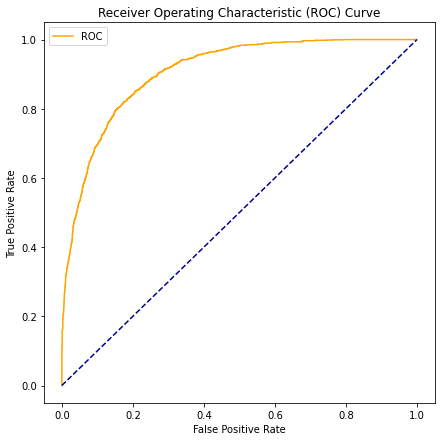

In [37]:
def plot_roc_curve(fpr, tpr):
    plt.plot(fpr, tpr, color='orange', label='ROC')
    plt.plot([0, 1], [0, 1], color='darkblue', linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend()
    plt.show()
    
pos_probs = predictionProbabilities

fpr, tpr, thresholds = roc_curve(testLabels, pos_probs, pos_label = 1)

# calculate scores
lr_auc = roc_auc_score(testLabels, pos_probs)
print('AUC Score = %.3f' % (lr_auc * 100))
plt.rcParams['figure.figsize'] = [7, 7]
plot_roc_curve(fpr, tpr)